# Kaggle New York City Taxi Trip Duration Prediction

## Libraries

In [1]:
import pandas as pd 
import numpy as np 
import seaborn as sns
import kaggle
import matplotlib.pyplot as plt

## Data Importation

In [2]:
# #Download data from Kaggle
# !kaggle competitions download -c 'nyc-taxi-trip-duration' -p '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [3]:
# #Unzip the global file
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/nyc-taxi-trip-duration.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [4]:
# #Unzip the training set
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/train.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [5]:
# #Unzip the testing set
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/test.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

In [6]:
# #Unzip the submission file
# !unzip "/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/sample_submission.zip" -d '/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data'

## Data reading

In [7]:
#Read the csv files
train = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/train.csv')
test = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/test.csv')
submit = pd.read_csv('/Users/spavot/Documents/Perso/Data Science /GitHub/Kaggle New York City Taxi Trip Duration/Data/sample_submission.csv')

## Data exploration

In [8]:
#Check the variable we have
train.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1458644 entries, 0 to 1458643
Data columns (total 11 columns):
 #   Column              Non-Null Count    Dtype  
---  ------              --------------    -----  
 0   id                  1458644 non-null  object 
 1   vendor_id           1458644 non-null  int64  
 2   pickup_datetime     1458644 non-null  object 
 3   dropoff_datetime    1458644 non-null  object 
 4   passenger_count     1458644 non-null  int64  
 5   pickup_longitude    1458644 non-null  float64
 6   pickup_latitude     1458644 non-null  float64
 7   dropoff_longitude   1458644 non-null  float64
 8   dropoff_latitude    1458644 non-null  float64
 9   store_and_fwd_flag  1458644 non-null  object 
 10  trip_duration       1458644 non-null  int64  
dtypes: float64(4), int64(3), object(4)
memory usage: 122.4+ MB


We have 11 variables with id which is the trip id and the trip_duration which is our target. We end with 9 original variables as predictors. Let's firt observe the target.

#### Target inspection:

In [9]:
#Summary statistic
train.trip_duration.describe()

count    1.458644e+06
mean     9.594923e+02
std      5.237432e+03
min      1.000000e+00
25%      3.970000e+02
50%      6.620000e+02
75%      1.075000e+03
max      3.526282e+06
Name: trip_duration, dtype: float64

Seems like we have some outliers, let's try to identify them:

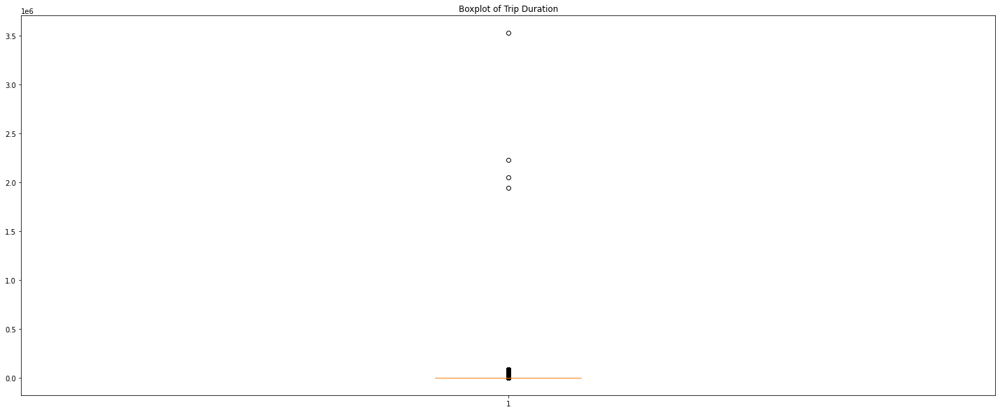

In [10]:
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train['trip_duration'])
plt.title('Boxplot of Trip Duration')
plt.show()

The boxplot visualization shows that 4 trip have a duration higher than 2*1e6 seconds which is at least 2 millions seconds which means those trip duration were at least 555 hours. It seems impossible and those values are out liers we need to filter out.

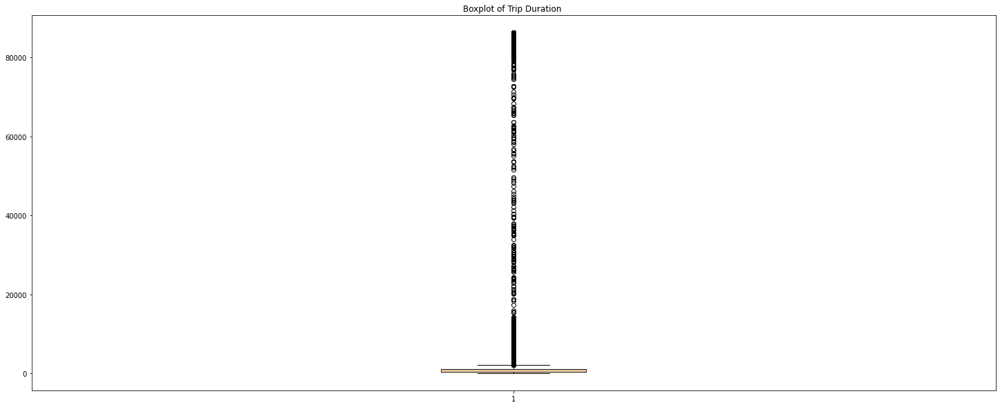

In [11]:
train_filtered = train[train['trip_duration']<1000000] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_filtered['trip_duration'])
plt.title('Boxplot of Trip Duration outliers removed')
plt.show()

It is better but we still have many trip that last for more than 10 000 seconds which means approximatively 3 hours. Let's try again but keeping only records less than 3 hours.

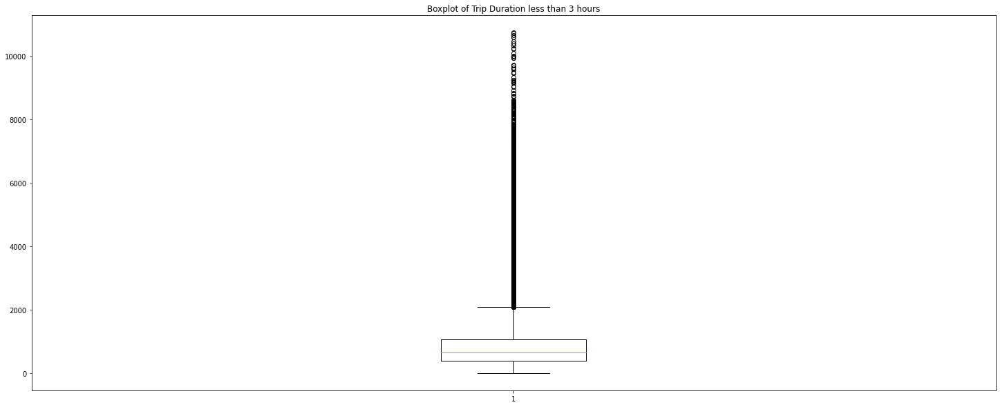

In [12]:
train_filtered_V2 = train[train['trip_duration']<=10800] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_filtered_V2['trip_duration'])
plt.title('Boxplot of Trip Duration less than 3 hours')
plt.show()

It looks better, we now have trip that maximum last 3 hours, let's see the distribution:

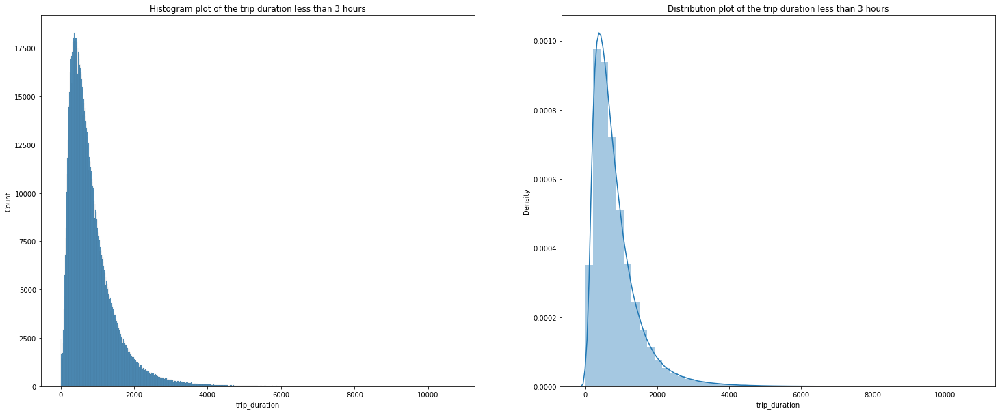

In [19]:
fig, ax = plt.subplots(1,2, figsize=(25,10))
#Histogram plot
sns.histplot(train_filtered_V2['trip_duration'], ax=ax[0])
ax[0].set_title('Histogram plot of the trip duration less than 3 hours')
#Density plot
sns.distplot(train_filtered_V2['trip_duration'], ax=ax[1])
ax[1].set_title('Distribution plot of the trip duration less than 3 hours')
plt.show()

We have some extremes values and the distribution is right skewed but this seems better. Let's try to see how the distribution would look with a log transform:

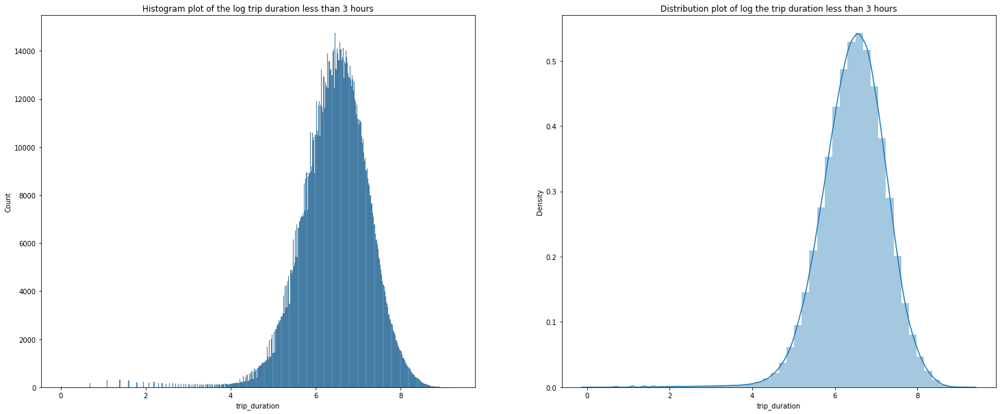

In [20]:
fig, ax = plt.subplots(1,2, figsize=(25,10))
#Histogram plot
sns.histplot(np.log(train_filtered_V2['trip_duration']), ax=ax[0])
ax[0].set_title('Histogram plot of the log trip duration less than 3 hours')
#Density plot
sns.distplot(np.log(train_filtered_V2['trip_duration']), ax=ax[1])
ax[1].set_title('Distribution plot of log the trip duration less than 3 hours')
plt.show()

The log transformation seems nice, but we might want to investigate the trip duration that are very low. Let's plot the trip that last less than 5 minutes to see if we have really low values:

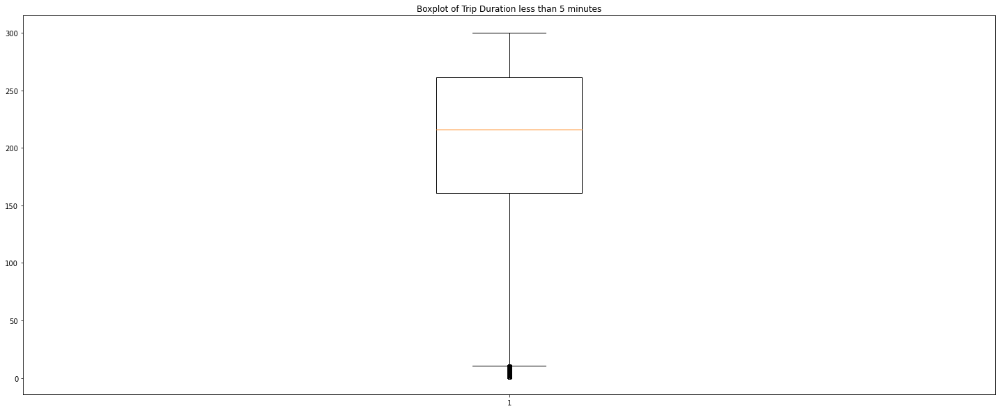

In [21]:
train_low_trip = train[train['trip_duration']<=300] 
fig, ax = plt.subplots(figsize=(25,10))
plt.boxplot(train_low_trip['trip_duration'])
plt.title('Boxplot of Trip Duration less than 5 minutes')
plt.show()

Seems that some trip duration are less than 30 secondes which doesn't seems realistic, we can assume that at least trips should last 1 minute.

We can conclude that removing trip with duration less than 1 minute and more than 3 hours seems reasonable regarding the data distribution. Also, applying a log transformation seems to let us obtain a distribution close to gaussian distribution which is appreciable. Furthermore, the metric of this Kaggle is the root mean squarred logarithmic error so it would be easier with the transformation. We will still need to encode back the log transformation of the prediction before submitting the predictions.

#### Predictors inspection:

We have for now 9 predictors before feature engineering, let's analyze them one by one:

Vendor_id:

In [25]:
train.vendor_id.value_counts()

2    780302
1    678342
Name: vendor_id, dtype: int64